<img src="https://clipart-library.com/images/8c65X4a9i.gif "/>

# Project: NYC 311 Service Request Analysis

# Environment Setup

In [1]:
# import pandas as pd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as mn #visualizing missing data
import plotly.express as px
import plotly.io as pio
pio.renderers.default = "notebook"
#pio.templates.default = "simple_white"
pio.templates.default = "plotly_dark"
import warnings
warnings.filterwarnings('ignore')
from sklearn.impute import SimpleImputer
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [2]:
nyc_df = pd.read_csv("311_Service_Requests_from_2010_to_Present.csv")
nyc_df.head()

,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Garage Lot Name,Ferry Direction,Ferry Terminal Name,Latitude,Longitude,Location
0,32310363,12/31/2015 11:59:45 PM,01/01/2016 12:55:15 AM,NYPD,New York City Police Department,Noise - Street/Sidewalk,Loud Music/Party,Street/Sidewalk,10034.0,71 VERMILYEA AVENUE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.865682,-73.923501,"(40.86568153633767, -73.92350095571744)"
1,32309934,12/31/2015 11:59:44 PM,01/01/2016 01:26:57 AM,NYPD,New York City Police Department,Blocked Driveway,No Access,Street/Sidewalk,11105.0,27-07 23 AVENUE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.775945,-73.915094,"(40.775945312321085, -73.91509393898605)"
2,32309159,12/31/2015 11:59:29 PM,01/01/2016 04:51:03 AM,NYPD,New York City Police Department,Blocked Driveway,No Access,Street/Sidewalk,10458.0,2897 VALENTINE AVENUE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.870325,-73.888525,"(40.870324522111424, -73.88852464418646)"
3,32305098,12/31/2015 11:57:46 PM,01/01/2016 07:43:13 AM,NYPD,New York City Police Department,Illegal Parking,Commercial Overnight Parking,Street/Sidewalk,10461.0,2940 BAISLEY AVENUE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.835994,-73.828379,"(40.83599404683083, -73.82837939584206)"
4,32306529,12/31/2015 11:56:58 PM,01/01/2016 03:24:42 AM,NYPD,New York City Police Department,Illegal Parking,Blocked Sidewalk,Street/Sidewalk,11373.0,87-14 57 ROAD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.733060,-73.874170,"(40.733059618956815, -73.87416975810375)"


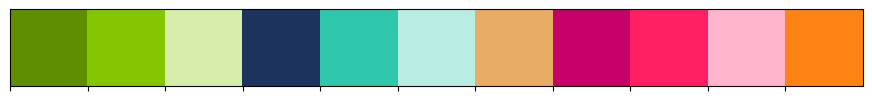

In [3]:
#color palette for this notebook
colors = ["#5f8e00","#84c600","#d6ecaa","#1c335e","#2ec7ab","#b9ece3",\
"#e8ac65","#c7006a","#ff1f62","#ffb4cb","#ff8214"]
palette = sns.color_palette(palette = colors)

sns.palplot(palette, size =1)
plt.show()

# Basic data exploratory analysis

In [4]:
''' 
It could be seen that, for numerical atrributes: 
`School or Citywide Complaint`, `Verhicle Type` , `Taxi Company Borough`, `Taxi Pick Up Location` and `Garage Lot Name` are all missing values
with their count of row equals to 0 and all other statistical value are NaN.
Hence, we should dropna for these 5 columns.
'''
nyc_df.describe()

,Unique Key,Incident Zip,X Coordinate (State Plane),Y Coordinate (State Plane),School or Citywide Complaint,Vehicle Type,Taxi Company Borough,Taxi Pick Up Location,Garage Lot Name,Latitude,Longitude
count,3.645580e+05,361560.000000,3.605280e+05,360528.000000,0.0,0.0,0.0,0.0,0.0,360528.000000,360528.000000
mean,3.106595e+07,10858.496659,1.005043e+06,203425.305782,NaN,NaN,NaN,NaN,NaN,40.724980,-73.924946
std,7.331531e+05,578.263114,2.196362e+04,29842.192857,NaN,NaN,NaN,NaN,NaN,0.081907,0.079213
min,2.960737e+07,83.000000,9.133570e+05,121185.000000,NaN,NaN,NaN,NaN,NaN,40.499040,-74.254937
25%,3.049938e+07,10314.000000,9.919460e+05,182945.000000,NaN,NaN,NaN,NaN,NaN,40.668742,-73.972253
50%,3.108795e+07,11209.000000,1.003470e+06,201023.000000,NaN,NaN,NaN,NaN,NaN,40.718406,-73.930643
75%,3.167433e+07,11238.000000,1.019134e+06,222790.000000,NaN,NaN,NaN,NaN,NaN,40.778166,-73.874098
max,3.231065e+07,11697.000000,1.067186e+06,271876.000000,NaN,NaN,NaN,NaN,NaN,40.912869,-73.700715


In [5]:
nyc_df.describe(include= "object")

,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Address,Street Name,Cross Street 1,...,School State,School Zip,School Not Found,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Ferry Direction,Ferry Terminal Name,Location
count,364558,362177,364558,364558,364558,358057,364425,312859,312859,307370,...,364558,364557,364558,297,297,262,262,1,2,360528
unique,362018,339837,1,3,24,45,18,126372,7693,6234,...,2,1,1,29,34,2,187,1,2,146751
top,02/11/2015 10:56:36 PM,09/10/2015 07:12:49 AM,NYPD,New York City Police Department,Blocked Driveway,No Access,Street/Sidewalk,1207 BEACH AVENUE,BROADWAY,BEND,...,Unspecified,Unspecified,N,FDR Dr,East/Queens Bound,Roadway,East 96th St (Exit 14) - Triborough Br (Exit 17),Manhattan Bound,St. George Terminal (Staten Island),"(40.83036235589997, -73.86602154214397)"
freq,3,3,364558,364548,100881,75888,301372,1014,4122,5123,...,364557,364557,364558,36,26,199,6,1,1,1012


In [6]:
''' 
We have 53 attributes and 364.588 observations.
'''
nyc_df.shape

(364558, 53)

In [7]:
''' 
For object data type, there are 25 columns has null values and 17 completes columns.
'''
nyc_df.select_dtypes('object').isna().any().value_counts()

True     25
False    17
Name: count, dtype: int64

In [8]:
''' 
For numeric data type, there are 10 columns has null values and only 1 completes columns.
'''
nyc_df.select_dtypes('number').isna().any().value_counts()

True     10
False     1
Name: count, dtype: int64

### Cleaning Missing Values

<Axes: >

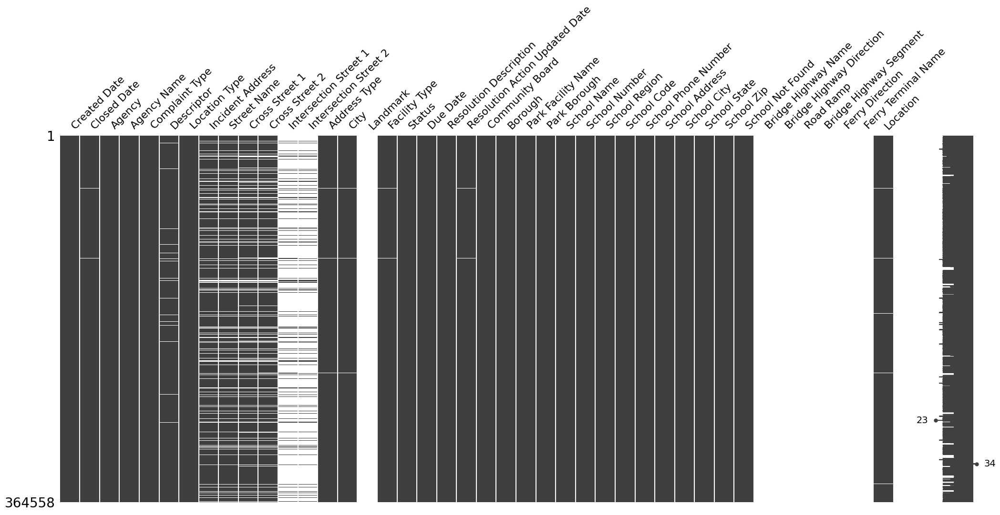

In [9]:
''' 
We could see many columns are filled with Null Values.
Columns that are totally missing values: Landmark, Bridge Highway Name, Bridge Highway Direction, Road Ramp, Bridge Highway Segment, Ferry Direction Ferry Terminal Name.
--> Total 7 columns 
'''
mn.matrix(nyc_df.select_dtypes(include='object'))

<Axes: >

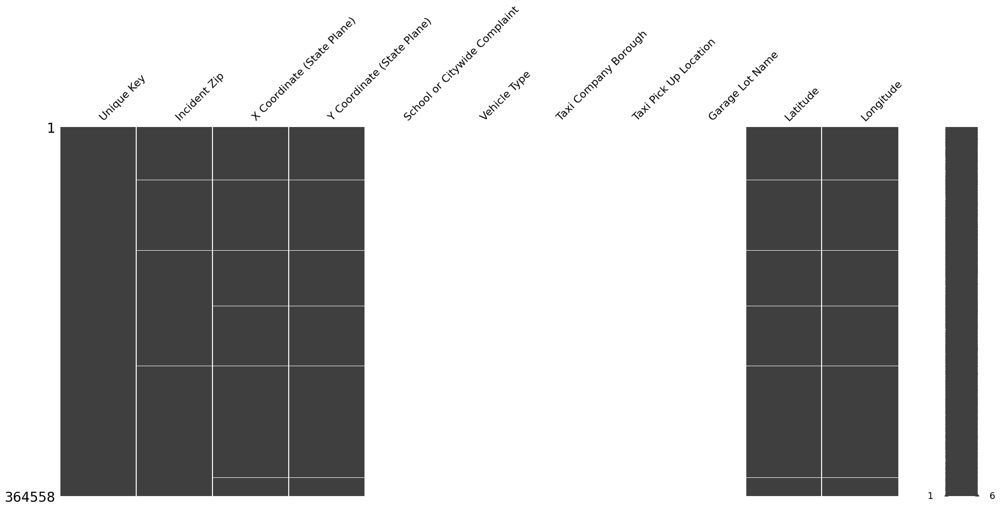

In [10]:
mn.matrix(nyc_df.select_dtypes(include='number'))

In [11]:
pio.templates

Templates configuration
-----------------------
    Default template: 'plotly_dark'
    Available templates:
        ['ggplot2', 'seaborn', 'simple_white', 'plotly',
         'plotly_white', 'plotly_dark', 'presentation', 'xgridoff',
         'ygridoff', 'gridon', 'none']

In [12]:
'''  
There are 9 columns has the null percentage over 80% 
and 4 columns has the null percentage over 10%
--> we will drop these columns.
'''
columns = []
perc_null = []
for column in nyc_df.select_dtypes(include='object'):
    columns.append(column)
    perc_null.append(round(nyc_df[column].isna().sum()*100/nyc_df.shape[0], 2))

obj_null_calc = pd.DataFrame(list(zip(columns,perc_null)), columns=['Column','Null Percentage'])

fig = px.bar(data_frame=obj_null_calc, x='Column', y ='Null Percentage', color='Column', color_discrete_sequence = colors,
             title= "[Object] Null percentage per column", text='Null Percentage')
fig.update_layout(showlegend = False)
fig.update_traces(textposition='inside')
fig.show()

In [13]:
numeric_columns = []
numeric_perc_null = []

for col in nyc_df.select_dtypes(include= 'number'):
    numeric_columns.append(col)
    numeric_perc_null.append(round(nyc_df[col].isna().sum()*100/nyc_df.shape[0],2))
num_null_calc = pd.DataFrame(list(zip(numeric_columns,numeric_perc_null)), columns=['Columns','Null Percentage'])
fig = px.bar(data_frame=num_null_calc, x='Columns', y='Null Percentage', color='Columns', color_discrete_sequence=colors,
       title='[Numeric] Null percentage per column', text = 'Null Percentage')
fig.update_traces(textposition='inside')
fig.update_layout(showlegend=False)
fig.show()

In [14]:
'''  
Drop columns with greater then >10% null percentage
=> obj + numberic columns = 18 columns will be dropped
'''

limit_null = nyc_df.shape[0]*0.9
nyc_df_clean = nyc_df.dropna(axis=1, thresh= limit_null)
nyc_df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 364558 entries, 0 to 364557
Data columns (total 35 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   Unique Key                      364558 non-null  int64  
 1   Created Date                    364558 non-null  object 
 2   Closed Date                     362177 non-null  object 
 3   Agency                          364558 non-null  object 
 4   Agency Name                     364558 non-null  object 
 5   Complaint Type                  364558 non-null  object 
 6   Descriptor                      358057 non-null  object 
 7   Location Type                   364425 non-null  object 
 8   Incident Zip                    361560 non-null  float64
 9   Address Type                    361306 non-null  object 
 10  City                            361561 non-null  object 
 11  Facility Type                   362169 non-null  object 
 12  Status          

In [15]:
'''  
Since we have 4 columns described the position of incindent on map, which are lat/long and x/y coordinate.
I would refer to use lat/long then, i will drop these 2 x/y coordinate columns as well as location column (which contains the paired of lat/long).
And I don't need the Incident Zip as well
'''
nyc_df_clean.drop(columns=['X Coordinate (State Plane)','Y Coordinate (State Plane)', 'Location', 'Incident Zip'], inplace=True)
nyc_df_clean.shape


(364558, 31)

<Axes: >

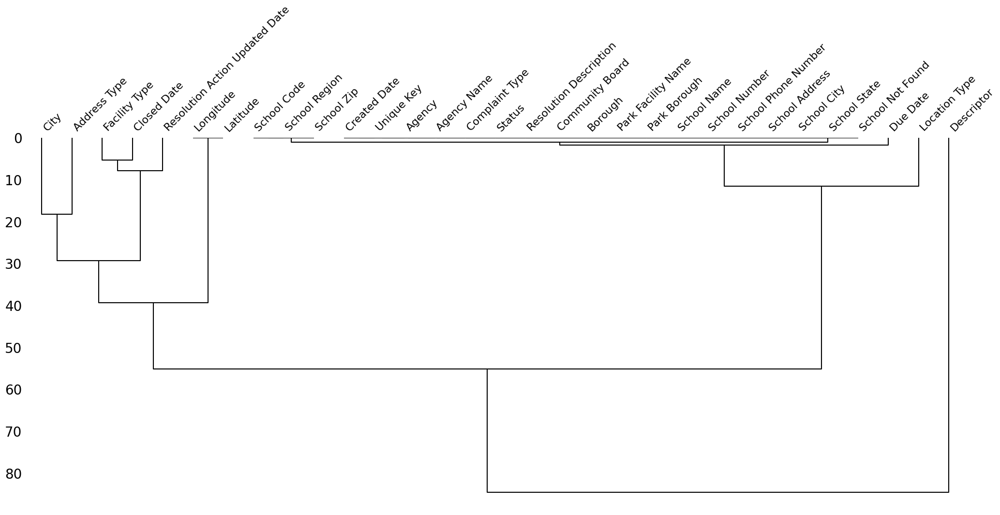

In [16]:
mn.dendrogram(nyc_df_clean)

In [17]:
null_column = pd.Series(nyc_df_clean.isna().sum(), name='Value').to_frame()
null_column

,Value
Unique Key,0
Created Date,0
Closed Date,2381
Agency,0
Agency Name,0
Complaint Type,0
Descriptor,6501
Location Type,133
Address Type,3252
City,2997


In [18]:
'''  
For `Descriptor`, `Location Type`, `Address Type`, `City`, `Facility Type` column, i will fill the null with 'Unspecified'
For `Longitude` and `Latitude` , since the dataset is all centered in NYC. I will replace null value with the mode.
'''

fill_unspecified_list = ['Descriptor', 'Location Type', 'Address Type', 'City', 'Facility Type']
for col in fill_unspecified_list:
    nyc_df_clean[col] = nyc_df_clean[col].fillna('Unspecified')

In [19]:
'''  
We could see that all the columns start with 'School' have the top is unspecified. 
And the 'school not found' has only 1 value is 'N' which is not informative.
Hence, we will drop all these columns.
'''
nyc_df_clean.loc[:,nyc_df_clean.columns.str.startswith('School')].describe()

,School Name,School Number,School Region,School Code,School Phone Number,School Address,School City,School State,School Zip,School Not Found
count,364558,364558,364557,364557,364558,364558,364558,364558,364557,364558
unique,2,2,1,1,2,2,2,2,1,1
top,Unspecified,Unspecified,Unspecified,Unspecified,Unspecified,Unspecified,Unspecified,Unspecified,Unspecified,N
freq,364557,364557,364557,364557,364557,364557,364557,364557,364557,364558


In [20]:
nyc_df_clean.drop(columns=nyc_df_clean.loc[:,nyc_df_clean.columns.str.startswith('School')].columns.values, inplace=True)
nyc_df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 364558 entries, 0 to 364557
Data columns (total 21 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   Unique Key                      364558 non-null  int64  
 1   Created Date                    364558 non-null  object 
 2   Closed Date                     362177 non-null  object 
 3   Agency                          364558 non-null  object 
 4   Agency Name                     364558 non-null  object 
 5   Complaint Type                  364558 non-null  object 
 6   Descriptor                      364558 non-null  object 
 7   Location Type                   364558 non-null  object 
 8   Address Type                    364558 non-null  object 
 9   City                            364558 non-null  object 
 10  Facility Type                   364558 non-null  object 
 11  Status                          364558 non-null  object 
 12  Due Date        

In [21]:
nyc_df_clean['Longitude'] = nyc_df_clean['Longitude'].fillna(nyc_df_clean['Longitude'].mode()[0])
nyc_df_clean['Latitude'] = nyc_df_clean['Latitude'].fillna(nyc_df_clean['Latitude'].mode()[0])

In [22]:
nyc_df_clean.loc[:,nyc_df_clean.columns.str.endswith('Date')]

,Created Date,Closed Date,Due Date,Resolution Action Updated Date
0,12/31/2015 11:59:45 PM,01/01/2016 12:55:15 AM,01/01/2016 07:59:45 AM,01/01/2016 12:55:15 AM
1,12/31/2015 11:59:44 PM,01/01/2016 01:26:57 AM,01/01/2016 07:59:44 AM,01/01/2016 01:26:57 AM
2,12/31/2015 11:59:29 PM,01/01/2016 04:51:03 AM,01/01/2016 07:59:29 AM,01/01/2016 04:51:03 AM
3,12/31/2015 11:57:46 PM,01/01/2016 07:43:13 AM,01/01/2016 07:57:46 AM,01/01/2016 07:43:13 AM
4,12/31/2015 11:56:58 PM,01/01/2016 03:24:42 AM,01/01/2016 07:56:58 AM,01/01/2016 03:24:42 AM
...,...,...,...,...
364553,01/01/2015 12:04:44 AM,01/01/2015 10:22:31 AM,01/01/2015 08:04:44 AM,01/01/2015 10:22:31 AM
364554,01/01/2015 12:04:28 AM,01/01/2015 02:25:02 AM,01/01/2015 08:04:28 AM,01/01/2015 02:25:02 AM
364555,01/01/2015 12:01:30 AM,01/01/2015 12:20:33 AM,01/01/2015 08:01:30 AM,01/01/2015 12:20:33 AM
364556,01/01/2015 12:01:29 AM,01/01/2015 02:42:22 AM,01/01/2015 08:01:29 AM,01/01/2015 02:42:22 AM


In [23]:
date_type_column = nyc_df_clean.loc[:, nyc_df_clean.columns.str.endswith('Date')].columns.values
for col in date_type_column:
    nyc_df_clean[col] = pd.to_datetime(nyc_df_clean[col], format='%m/%d/%Y %I:%M:%S %p')
    #nyc_df_clean[col] = nyc_df_clean[col].dt.strftime('%m/%d/%Y %H:%M:%S')

nyc_df_clean.loc[:,nyc_df_clean.columns.str.endswith('Date')]

,Created Date,Closed Date,Due Date,Resolution Action Updated Date
0,2015-12-31 23:59:45,2016-01-01 00:55:15,2016-01-01 07:59:45,2016-01-01 00:55:15
1,2015-12-31 23:59:44,2016-01-01 01:26:57,2016-01-01 07:59:44,2016-01-01 01:26:57
2,2015-12-31 23:59:29,2016-01-01 04:51:03,2016-01-01 07:59:29,2016-01-01 04:51:03
3,2015-12-31 23:57:46,2016-01-01 07:43:13,2016-01-01 07:57:46,2016-01-01 07:43:13
4,2015-12-31 23:56:58,2016-01-01 03:24:42,2016-01-01 07:56:58,2016-01-01 03:24:42
...,...,...,...,...
364553,2015-01-01 00:04:44,2015-01-01 10:22:31,2015-01-01 08:04:44,2015-01-01 10:22:31
364554,2015-01-01 00:04:28,2015-01-01 02:25:02,2015-01-01 08:04:28,2015-01-01 02:25:02
364555,2015-01-01 00:01:30,2015-01-01 00:20:33,2015-01-01 08:01:30,2015-01-01 00:20:33
364556,2015-01-01 00:01:29,2015-01-01 02:42:22,2015-01-01 08:01:29,2015-01-01 02:42:22


In [24]:
nyc_df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 364558 entries, 0 to 364557
Data columns (total 21 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   Unique Key                      364558 non-null  int64         
 1   Created Date                    364558 non-null  datetime64[ns]
 2   Closed Date                     362177 non-null  datetime64[ns]
 3   Agency                          364558 non-null  object        
 4   Agency Name                     364558 non-null  object        
 5   Complaint Type                  364558 non-null  object        
 6   Descriptor                      364558 non-null  object        
 7   Location Type                   364558 non-null  object        
 8   Address Type                    364558 non-null  object        
 9   City                            364558 non-null  object        
 10  Facility Type                   364558 non-null  object 

In [25]:
'''  
We could seen that the complaint type Ferry Complaint has no Due Date and Closed Date and 1 missing Value on Resolution Action Updated Date
So it is not informative for us, we will drop these rows.
'''
display(nyc_df_clean[nyc_df_clean['Complaint Type']=='Ferry Complaint'][['Complaint Type','Created Date', 'Due Date','Closed Date']])
nyc_df_clean[nyc_df_clean['Complaint Type']=='Ferry Complaint'].info()

,Complaint Type,Created Date,Due Date,Closed Date
161610,Ferry Complaint,2015-08-03 08:28:29,NaT,NaT
192974,Ferry Complaint,2015-07-06 09:12:34,NaT,NaT


<class 'pandas.core.frame.DataFrame'>
Index: 2 entries, 161610 to 192974
Data columns (total 21 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   Unique Key                      2 non-null      int64         
 1   Created Date                    2 non-null      datetime64[ns]
 2   Closed Date                     0 non-null      datetime64[ns]
 3   Agency                          2 non-null      object        
 4   Agency Name                     2 non-null      object        
 5   Complaint Type                  2 non-null      object        
 6   Descriptor                      2 non-null      object        
 7   Location Type                   2 non-null      object        
 8   Address Type                    2 non-null      object        
 9   City                            2 non-null      object        
 10  Facility Type                   2 non-null      object        
 11  Statu

In [26]:
nyc_df_clean = nyc_df_clean.drop(nyc_df_clean[(nyc_df_clean['Complaint Type'] == 'Ferry Complaint') & (nyc_df_clean['Due Date'].isnull())].index)
nyc_df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 364556 entries, 0 to 364557
Data columns (total 21 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   Unique Key                      364556 non-null  int64         
 1   Created Date                    364556 non-null  datetime64[ns]
 2   Closed Date                     362177 non-null  datetime64[ns]
 3   Agency                          364556 non-null  object        
 4   Agency Name                     364556 non-null  object        
 5   Complaint Type                  364556 non-null  object        
 6   Descriptor                      364556 non-null  object        
 7   Location Type                   364556 non-null  object        
 8   Address Type                    364556 non-null  object        
 9   City                            364556 non-null  object        
 10  Facility Type                   364556 non-null  object      

In [27]:
'''  
For the remain row of Due Date is NaT and resolution action updated date is NaT. We could see that the Closed Date is same day with the Created Date. 
So I will fill NaT for Due Date and Resolution Action with the same Closed Date.
'''
nyc_df_clean[nyc_df_clean['Due Date'].isnull()]

,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Address Type,City,...,Status,Due Date,Resolution Description,Resolution Action Updated Date,Community Board,Borough,Park Facility Name,Park Borough,Latitude,Longitude
175921,31129107,2015-07-21 16:05:39,2015-07-21 21:56:38,NYPD,NYPD,Blocked Driveway,No Access,Unspecified,ADDRESS,BROOKLYN,...,Draft,NaT,The Police Department responded to the complai...,NaT,10 BROOKLYN,BROOKLYN,Unspecified,BROOKLYN,40.625772,-73.999564


In [28]:
mask = (nyc_df_clean['Due Date'].isnull()) & (nyc_df_clean['Resolution Action Updated Date'].isnull())
nyc_df_clean.loc[mask, ['Due Date', 'Resolution Action Updated Date']] = nyc_df_clean.loc[mask, 'Closed Date']

In [29]:
nyc_df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 364556 entries, 0 to 364557
Data columns (total 21 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   Unique Key                      364556 non-null  int64         
 1   Created Date                    364556 non-null  datetime64[ns]
 2   Closed Date                     362177 non-null  datetime64[ns]
 3   Agency                          364556 non-null  object        
 4   Agency Name                     364556 non-null  object        
 5   Complaint Type                  364556 non-null  object        
 6   Descriptor                      364556 non-null  object        
 7   Location Type                   364556 non-null  object        
 8   Address Type                    364556 non-null  object        
 9   City                            364556 non-null  object        
 10  Facility Type                   364556 non-null  object      

In [30]:
nyc_df_clean[(nyc_df_clean['Closed Date'].isnull()) & (nyc_df_clean['Resolution Action Updated Date'].isnull())]

,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Address Type,City,...,Status,Due Date,Resolution Description,Resolution Action Updated Date,Community Board,Borough,Park Facility Name,Park Borough,Latitude,Longitude
416,32305700,2015-12-31 14:16:04,NaT,NYPD,New York City Police Department,Illegal Parking,Posted Parking Sign Violation,Street/Sidewalk,Unspecified,Unspecified,...,Open,2015-12-31 22:16:04,Your complaint has been forwarded to the New Y...,NaT,0 Unspecified,Unspecified,Unspecified,Unspecified,40.830362,-73.866022
611,32309308,2015-12-31 09:58:06,NaT,NYPD,New York City Police Department,Noise - Street/Sidewalk,Loud Music/Party,Street/Sidewalk,Unspecified,Unspecified,...,Open,2015-12-31 17:58:06,Your complaint has been forwarded to the New Y...,NaT,0 Unspecified,Unspecified,Unspecified,Unspecified,40.830362,-73.866022
1648,32303348,2015-12-30 05:13:42,NaT,NYPD,New York City Police Department,Illegal Parking,Commercial Overnight Parking,Street/Sidewalk,Unspecified,Unspecified,...,Open,2015-12-30 13:13:42,Your complaint has been forwarded to the New Y...,NaT,0 Unspecified,Unspecified,Unspecified,Unspecified,40.830362,-73.866022
1816,32294519,2015-12-29 22:44:50,NaT,NYPD,New York City Police Department,Derelict Vehicle,With License Plate,Street/Sidewalk,Unspecified,Unspecified,...,Open,2015-12-30 06:44:50,Your complaint has been forwarded to the New Y...,NaT,0 Unspecified,Unspecified,Unspecified,Unspecified,40.830362,-73.866022
1965,32296487,2015-12-29 19:09:13,NaT,NYPD,New York City Police Department,Derelict Vehicle,With License Plate,Street/Sidewalk,Unspecified,Unspecified,...,Open,2015-12-30 03:09:13,Your complaint has been forwarded to the New Y...,NaT,0 Unspecified,Unspecified,Unspecified,Unspecified,40.830362,-73.866022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
363643,29618691,2015-01-02 11:38:52,NaT,NYPD,New York City Police Department,Derelict Vehicle,With License Plate,Street/Sidewalk,Unspecified,Unspecified,...,Open,2015-01-02 19:38:52,Your complaint has been forwarded to the New Y...,NaT,0 Unspecified,Unspecified,Unspecified,Unspecified,40.830362,-73.866022
363789,29619230,2015-01-02 07:25:16,NaT,NYPD,New York City Police Department,Illegal Parking,Posted Parking Sign Violation,Street/Sidewalk,Unspecified,Unspecified,...,Open,2015-01-02 15:25:16,Your complaint has been forwarded to the New Y...,NaT,0 Unspecified,Unspecified,Unspecified,Unspecified,40.830362,-73.866022
363805,29618672,2015-01-02 06:14:06,NaT,NYPD,New York City Police Department,Derelict Vehicle,With License Plate,Street/Sidewalk,Unspecified,Unspecified,...,Open,2015-01-02 14:14:06,Your complaint has been forwarded to the New Y...,NaT,0 Unspecified,Unspecified,Unspecified,Unspecified,40.830362,-73.866022
364151,29617561,2015-01-01 16:04:35,NaT,NYPD,New York City Police Department,Illegal Parking,Blocked Hydrant,Street/Sidewalk,Unspecified,Unspecified,...,Assigned,2015-01-02 00:04:35,Your complaint has been forwarded to the New Y...,NaT,0 Unspecified,Unspecified,Unspecified,Unspecified,40.830362,-73.866022


In [31]:
''' 
We could seen the closed date is nan because the status hasn't closed yet.
So there is not problem with this column.
But the draft status seems to be useless so i will drop that row.
'''
nyc_df_clean.groupby('Status')['Closed Date'].apply(lambda x: x.isnull().sum())

Status
Assigned     776
Closed         0
Draft          1
Open        1602
Name: Closed Date, dtype: int64

In [32]:
nyc_df_clean = nyc_df_clean[nyc_df_clean['Status'] != 'Draft']
nyc_df_clean['Status'].value_counts()

Status
Closed      362114
Open          1638
Assigned       802
Name: count, dtype: int64

In [33]:
nyc_df_clean.groupby('Status')['Resolution Action Updated Date'].apply(lambda x: x.isnull().sum())

Status
Assigned     760
Closed         2
Open        1637
Name: Resolution Action Updated Date, dtype: int64

In [34]:
''' The Resolution Action was missing for closed status. But there were closed date already so i will replace these missing with it closed date'''
nyc_df_clean[(nyc_df_clean['Status'] == 'Closed') & (nyc_df_clean['Resolution Action Updated Date'].isnull())][['Closed Date','Due Date','Complaint Type','Resolution Description']]

,Closed Date,Due Date,Complaint Type,Resolution Description
175964,2015-07-21 17:24:17,2015-07-21 23:15:37,Illegal Parking,The Police Department responded to the complai...
294151,2015-04-05 21:09:42,2015-04-06 04:54:44,Blocked Driveway,Your complaint has been forwarded to the New Y...


In [35]:
mask2 = (nyc_df_clean['Status'] == 'Closed') & (nyc_df_clean['Resolution Action Updated Date'].isnull())
nyc_df_clean.loc[mask2,'Resolution Action Updated Date'] = nyc_df_clean.loc[mask2, 'Closed Date']

In [36]:
nyc_df_clean['Resolution Description'].value_counts()

Resolution Description
The Police Department responded to the complaint and with the information available observed no evidence of the violation at that time.                                                                                                                                                                                                                                                                                                                                                                               107051
The Police Department responded to the complaint and took action to fix the condition.                                                                                                                                                                                                                                                                                                                                                                                              

In [37]:
'''
The 'Your complaint has been forwarded to the New York Police Department for a non-emergency response. 311 will have additional information in 8 hours. Please note your service request number for future reference.'
solution has 100% null values for resolution action updated date.
'''
nyc_df_clean.groupby('Resolution Description')['Resolution Action Updated Date'].apply(lambda x: x.isnull().sum())

Resolution Description
The New York City Police Department received your comments and forwarded them to the appropriate unit for resolution. You may follow up by calling (646) 610-6952 after 60 days from submitting your agency issue.                                                                                                                                                                                                                                                                                                       0
The Police Department issued a summons in response to the complaint.                                                                                                                                                                                                                                                                                                                                                                                                                  

In [38]:
mask3 = nyc_df_clean['Resolution Description'] == 'Your complaint has been forwarded to the New York Police Department for a non-emergency response. 311 will have additional information in 8 hours. Please note your service request number for future reference.'
nyc_df_clean.loc[mask3, ['Created Date','Closed Date','Due Date']]

,Created Date,Closed Date,Due Date
416,2015-12-31 14:16:04,NaT,2015-12-31 22:16:04
611,2015-12-31 09:58:06,NaT,2015-12-31 17:58:06
1648,2015-12-30 05:13:42,NaT,2015-12-30 13:13:42
1816,2015-12-29 22:44:50,NaT,2015-12-30 06:44:50
1965,2015-12-29 19:09:13,NaT,2015-12-30 03:09:13
...,...,...,...
363643,2015-01-02 11:38:52,NaT,2015-01-02 19:38:52
363789,2015-01-02 07:25:16,NaT,2015-01-02 15:25:16
363805,2015-01-02 06:14:06,NaT,2015-01-02 14:14:06
364151,2015-01-01 16:04:35,NaT,2015-01-02 00:04:35


In [39]:
'''  
For these 2 resolution description, we will replace it with the created date + 15 minutes
'''

mask4 = (nyc_df_clean['Resolution Description'] == "Your complaint has been forwarded to the New York Police Department for a non-emergency response. If the police determine the vehicle is illegally parked, they will ticket the vehicle and then you may either contact a private towing company to remove the vehicle or ask your local precinct to contact 'rotation tow'. Any fees charged for towing will have to be paid by the vehicle owner. 311 will have additional information in 8 hours. Please note your service request number for future reference.")\
& (nyc_df_clean['Closed Date'].notnull())
nyc_df_clean.loc[mask4, ['Created Date','Closed Date','Due Date']]

,Created Date,Closed Date,Due Date
294151,2015-04-05 20:54:44,2015-04-05 21:09:42,2015-04-06 04:54:44


In [40]:
def fill_na_resolution_date(row):
    if pd.isnull(row['Resolution Action Updated Date']) and row['Resolution Description'] in ["Your complaint has been forwarded to the New York Police Department for a non-emergency response. 311 will have additional information in 8 hours. Please note your service request number for future reference.",
                                                                                              "Your complaint has been forwarded to the New York Police Department for a non-emergency response. If the police determine the vehicle is illegally parked, they will ticket the vehicle and then you may either contact a private towing company to remove the vehicle or ask your local precinct to contact 'rotation tow'. Any fees charged for towing will have to be paid by the vehicle owner. 311 will have additional information in 8 hours. Please note your service request number for future reference."]:
        return row['Created Date'] + pd.Timedelta(minutes=15)
    return row['Resolution Action Updated Date']

In [41]:
nyc_df_clean['Resolution Action Updated Date'] = nyc_df_clean.apply(fill_na_resolution_date, axis=1)
nyc_df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 364554 entries, 0 to 364557
Data columns (total 21 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   Unique Key                      364554 non-null  int64         
 1   Created Date                    364554 non-null  datetime64[ns]
 2   Closed Date                     362176 non-null  datetime64[ns]
 3   Agency                          364554 non-null  object        
 4   Agency Name                     364554 non-null  object        
 5   Complaint Type                  364554 non-null  object        
 6   Descriptor                      364554 non-null  object        
 7   Location Type                   364554 non-null  object        
 8   Address Type                    364554 non-null  object        
 9   City                            364554 non-null  object        
 10  Facility Type                   364554 non-null  object      

In [42]:
nyc_df_clean[nyc_df_clean['Resolution Action Updated Date'].isnull()]['Resolution Description'].value_counts()

Resolution Description
The Police Department responded to the complaint and took action to fix the condition.                                                     14
The Police Department responded and upon arrival those responsible for the condition were gone.                                             8
The Police Department responded to the complaint and with the information available observed no evidence of the violation at that time.     8
The Police Department responded to the complaint and determined that police action was not necessary.                                       5
The Police Department issued a summons in response to the complaint.                                                                        1
Name: count, dtype: int64

In [43]:
''' For the remain null value of resolution action updated date, we will replace with the max duration between resolution action updated date and created date
group by each resolution description '''

nyc_df_clean['duration'] = nyc_df_clean['Resolution Action Updated Date'] - nyc_df_clean['Created Date']
max_duration = nyc_df_clean.groupby('Resolution Description')['duration'].max()
def fill_na_with_max_duration(row):
    if pd.isnull(row['Resolution Action Updated Date']):
        resolution_desc = row['Resolution Description']
        max_duration_time = max_duration[resolution_desc]
        return row['Created Date'] + max_duration_time
    return row['Resolution Action Updated Date']




In [44]:
nyc_df_clean['Resolution Action Updated Date'] = nyc_df_clean.apply(fill_na_with_max_duration, axis = 1)
nyc_df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 364554 entries, 0 to 364557
Data columns (total 22 columns):
 #   Column                          Non-Null Count   Dtype          
---  ------                          --------------   -----          
 0   Unique Key                      364554 non-null  int64          
 1   Created Date                    364554 non-null  datetime64[ns] 
 2   Closed Date                     362176 non-null  datetime64[ns] 
 3   Agency                          364554 non-null  object         
 4   Agency Name                     364554 non-null  object         
 5   Complaint Type                  364554 non-null  object         
 6   Descriptor                      364554 non-null  object         
 7   Location Type                   364554 non-null  object         
 8   Address Type                    364554 non-null  object         
 9   City                            364554 non-null  object         
 10  Facility Type                   364554 non-null  

In [45]:
''' 
We could seen that the Park Borough has the same value with Borough, so we just need to keep one of them
Moreover, the Park Facility Name has a huge unspecified value, so we will drop this columnn.
'''
print(nyc_df_clean['Park Facility Name'].value_counts())
print((nyc_df_clean['Borough']==nyc_df_clean['Park Borough']).sum())

Park Facility Name
Unspecified                        364553
Alley Pond Park - Nature Center         1
Name: count, dtype: int64
364554


In [46]:
nyc_df_clean.drop(columns=['Park Borough','Park Facility Name','duration'], inplace=True)
nyc_df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 364554 entries, 0 to 364557
Data columns (total 19 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   Unique Key                      364554 non-null  int64         
 1   Created Date                    364554 non-null  datetime64[ns]
 2   Closed Date                     362176 non-null  datetime64[ns]
 3   Agency                          364554 non-null  object        
 4   Agency Name                     364554 non-null  object        
 5   Complaint Type                  364554 non-null  object        
 6   Descriptor                      364554 non-null  object        
 7   Location Type                   364554 non-null  object        
 8   Address Type                    364554 non-null  object        
 9   City                            364554 non-null  object        
 10  Facility Type                   364554 non-null  object      

# Analysis

### How many agencies here?

In [47]:
''' 
We could see that only one agency value has 3 different Agency Name.
Actually,  the Internal Affairs Bureau ("IAB") was set up as a unit within the NYPD that investigates serious police misconduct as well as police corruption.
Hence, we only have one agency here, it is NYDC or New York City Police Department.
So actually, these 2 columns aren't necessary.
We could drop them but i don't mind to keep them in the dataframe.
'''
nyc_df_clean.groupby('Agency')['Agency Name'].value_counts()

Agency  Agency Name                    
NYPD    New York City Police Department    364545
        Internal Affairs Bureau                 8
        NYPD                                    1
Name: count, dtype: int64

### How many complaint type are there?

In [48]:
complaint_type_counts = nyc_df_clean['Complaint Type'].value_counts()
fig = px.bar(x = complaint_type_counts.index, y = complaint_type_counts.values, color=complaint_type_counts.index, color_discrete_sequence=colors,
       title='Which one is the most complaint in NY?')
fig.update_layout(showlegend = False, xaxis_title = 'Complaint Type', yaxis_title='Number of Complaint')


In [49]:
borough_counts = nyc_df_clean.groupby('Borough').size().reset_index(name='Count')
fig = px.pie(borough_counts, values='Count', names='Borough', color_discrete_sequence=colors, title='Complaint Distribution by Borough')
fig.show()

In [50]:
complaint_counts = nyc_df_clean.groupby(['Borough', 'Complaint Type']).size().reset_index(name='Count')
complaint_counts = complaint_counts.sort_values(by=['Borough', 'Count'], ascending=[True, False])

num_boroughs = len(complaint_counts['Borough'].unique())
fig = make_subplots(rows=3, cols=2, subplot_titles=complaint_counts['Borough'].unique())
color_borough = colors[:len(complaint_counts['Borough'].unique())]

for i, (borough, color) in enumerate(zip(complaint_counts['Borough'].unique(), color_borough), 1):
    data_borough = complaint_counts[complaint_counts['Borough'] == borough]

    fig.add_trace(
        go.Bar(x=data_borough['Complaint Type'], y=data_borough['Count'], name=borough, marker=dict(color=color)),
        row=(i - 1) // 2 + 1, col=(i - 1) % 2 + 1  # Adjust the row and column indices
    )

fig.update_layout(
    height=600 * (num_boroughs/2),  # Adjust the height of the entire figure based on the number of unique Boroughs
    showlegend=False,  # Hide the legend
    title_text="Number of Complaint Types in each Borough (Sorted by Highest Count)",
    title_x=0.5  # Align the main title to the center
)
fig.show()


It looks like the popular type of complaint is blocked driveway and illegal parking.
These 2 type of complaints have the highest number of complaint received ticket to NYPD in BRONX, BROOKLYN, QUEENS, AND STATE ISLAND.
In MANHATTAN borough, the top 2 issues are all about Noise - Street/Sidewalk and Noise - Commercial.

For Blocked Driveway issue, there is 75% descriptor about 'No Access'
Meanwhile, for Illegal parking, most of the complaint is about Posted Parking sign Violation (29%) and Blocked Hydrant (22%)

In [51]:
blocked_driveway_df = nyc_df_clean[nyc_df_clean['Complaint Type'] == "Blocked Driveway"].groupby('Descriptor').size().reset_index(name = 'Count')
illegal_parking_df = nyc_df_clean[nyc_df_clean['Complaint Type'] == "Illegal Parking"].groupby('Descriptor').size().reset_index(name = 'Count')

fig = make_subplots(rows=1, cols=2, subplot_titles=['Blocked Driveway', 'Illegal Parking'], specs=[[{'type':'domain'}, {'type':'domain'}]])
# Add the pie chart for "Blocked Driveway" to the subplot
fig.add_trace(
    go.Pie(labels=blocked_driveway_df['Descriptor'], values=blocked_driveway_df['Count'], name='Blocked Driveway'),
    row=1, col=1
)
# Add the pie chart for "Illegal Parking" to the subplot
fig.add_trace(
    go.Pie(labels=illegal_parking_df['Descriptor'], values=illegal_parking_df['Count'], name='Illegal Parking'),
    row=1, col=2
)
fig.update_layout(
    title_text="Descriptor Distribution for Blocked Driveway and Illegal Parking",
    title_x=0.5
)
fig.update_traces( marker=dict(colors=colors, line=dict(color='#ffffff', width=1)))
fig.show()


## Status and Complaint Type Process

In [52]:
nyc_df_clean.groupby(['Complaint Type','Status']).size().reset_index(name='Count')

,Complaint Type,Status,Count
0,Agency Issues,Closed,8
1,Animal Abuse,Assigned,4
2,Animal Abuse,Closed,10528
3,Animal Abuse,Open,9
4,Animal in a Park,Closed,1
5,Bike/Roller/Skate Chronic,Assigned,1
6,Bike/Roller/Skate Chronic,Closed,475
7,Bike/Roller/Skate Chronic,Open,2
8,Blocked Driveway,Assigned,101
9,Blocked Driveway,Closed,100607


In [53]:
nyc_df_clean.groupby(['Borough','Status']).size().reset_index(name='Count')

,Borough,Status,Count
0,BRONX,Assigned,6
1,BRONX,Closed,49157
2,BRONX,Open,5
3,BROOKLYN,Assigned,20
4,BROOKLYN,Closed,118831
5,BROOKLYN,Open,12
6,MANHATTAN,Assigned,16
7,MANHATTAN,Closed,77428
8,MANHATTAN,Open,18
9,QUEENS,Assigned,10


In [54]:
nyc_df_status = nyc_df_clean['Status'].value_counts().reset_index(name='Count')
px.pie(nyc_df_status, values="Count", names="Status", color_discrete_sequence=colors, title="Distribution of Complaint Request Status")

Most of the complaint request has been closed (99,3%) . This means it had been resolved. 
There are 1638 requests are still opens and 802 requests have been assigned PIC.

#### Closed Status

In [55]:
closed_status_by_borough = nyc_df_clean[nyc_df_clean['Status']=='Closed'].groupby('Borough').size().reset_index(name='Count')
closed_status_by_borough['Percentage'] = closed_status_by_borough['Count']/(closed_status_by_borough['Count'].sum()) * 100
closed_status_by_borough.sort_values('Percentage', ascending=False)

,Borough,Count,Percentage
1,BROOKLYN,118831,32.815909
3,QUEENS,100732,27.817759
2,MANHATTAN,77428,21.382217
0,BRONX,49157,13.575007
4,STATEN ISLAND,15331,4.233750
5,Unspecified,635,0.175359


In [56]:
closed_status_by_complaint_type = nyc_df_clean[nyc_df_clean['Status']=='Closed'].groupby('Complaint Type').size().reset_index(name='Count')
closed_status_by_complaint_type['Percentage'] = closed_status_by_complaint_type['Count']/(closed_status_by_complaint_type['Count'].sum()) * 100
closed_status_by_complaint_type.sort_values('Percentage', ascending=False)

,Complaint Type,Count,Percentage
4,Blocked Driveway,100607,27.783240
11,Illegal Parking,91699,25.323241
15,Noise - Street/Sidewalk,51131,14.120139
12,Noise - Commercial,43749,12.081554
5,Derelict Vehicle,21515,5.941499
16,Noise - Vehicle,19300,5.329813
1,Animal Abuse,10528,2.907372
20,Traffic,5193,1.434079
9,Homeless Encampment,4873,1.345709
22,Vending,4183,1.155161


In [57]:
nyc_df_clean[nyc_df_clean['Status']=='Closed'][['Created Date', 'Due Date', 'Closed Date']].describe()

,Created Date,Due Date,Closed Date
count,362114,362114,362114
mean,2015-07-13 19:47:44.569066752,2015-07-14 03:48:13.533776640,2015-07-13 23:59:36.729438720
min,2015-01-01 00:00:50,2015-01-01 08:00:50,2015-01-01 00:20:33
25%,2015-04-28 08:09:39,2015-04-28 16:10:53,2015-04-28 11:49:37.750000128
50%,2015-07-15 21:42:19.500000,2015-07-16 05:46:32,2015-07-16 00:41:51
75%,2015-10-04 00:20:15,2015-10-04 08:20:15,2015-10-04 03:38:41.750000128
max,2015-12-31 23:59:45,2016-01-01 07:59:45,2016-01-03 16:22:52


In [58]:
closed_df = nyc_df_clean[nyc_df_clean['Status']=='Closed']
closed_df['Duration'] = closed_df['Closed Date'] - closed_df['Created Date']
closed_df['Duration in Hours'] = closed_df['Duration'].dt.total_seconds() / 3600
closed_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 362114 entries, 0 to 364557
Data columns (total 21 columns):
 #   Column                          Non-Null Count   Dtype          
---  ------                          --------------   -----          
 0   Unique Key                      362114 non-null  int64          
 1   Created Date                    362114 non-null  datetime64[ns] 
 2   Closed Date                     362114 non-null  datetime64[ns] 
 3   Agency                          362114 non-null  object         
 4   Agency Name                     362114 non-null  object         
 5   Complaint Type                  362114 non-null  object         
 6   Descriptor                      362114 non-null  object         
 7   Location Type                   362114 non-null  object         
 8   Address Type                    362114 non-null  object         
 9   City                            362114 non-null  object         
 10  Facility Type                   362114 non-null  

In [59]:
closed_df[['Duration','Duration in Hours']].head()

,Duration,Duration in Hours
0,0 days 00:55:30,0.925000
1,0 days 01:27:13,1.453611
2,0 days 04:51:34,4.859444
3,0 days 07:45:27,7.757500
4,0 days 03:27:44,3.462222


In [60]:
max_duration_closed = closed_df.groupby('Complaint Type')['Duration in Hours'].max().reset_index(name='Maximum').sort_values('Maximum', ascending=False)
fig = px.bar(max_duration_closed, x='Complaint Type', y ='Maximum',color='Complaint Type', color_discrete_sequence=colors, title = "Maximum duration to close a ticket by Complaint Type")
fig.update_layout(xaxis_title = 'Complaint Type', yaxis_title = 'Max Duration in Hours')

Most of complaint type will be closed or resolved under 2 weeks (approximately ~336 hours)
The top complaint type took longest hours to resolve is Noise - Street/Sidewalk and Noise - Commercial.

#### Time Analysis

In [61]:
nyc_df_clean['Created Date by Day'] = nyc_df_clean['Created Date'].dt.date
complaint_over_year = nyc_df_clean.groupby(['Created Date by Day', 'Complaint Type']).size().reset_index(name='Count').sort_values('Created Date by Day', ascending=True)
fig = px.area(complaint_over_year, x='Created Date by Day', y = 'Count', color='Complaint Type', color_discrete_sequence=colors)
fig.update_layout(xaxis_title='Date', yaxis_title='Number of Complaint', title = 'Number of Complaint Through Year')
fig.show()

The number of complaint started increasing since May 2015 due to the Noise - Street/Sidewalk while the Blocked Driveway started decreasing from May to end of September.

In [62]:
nyc_df_clean['Created Date by Hour'] = nyc_df_clean['Created Date'].dt.hour
complaint_over_hour = nyc_df_clean.groupby(['Created Date by Hour','Complaint Type']).size().reset_index(name='Count')
fig = px.area(complaint_over_hour, x='Created Date by Hour', y='Count', color='Complaint Type', color_discrete_sequence=colors, pattern_shape="Complaint Type")
fig.update_layout(xaxis_title='Number of Complaint', yaxis_title = 'Hour', title ='Number of Complaint in year 2015 by Hour')
fig.show()


It is easy to spot out that from 5 A.M the number of complaint created started increasing till midnight. 

In [63]:
day_of_week = {
    0 : "Monday",
    1: "Tuesday",
    2: "Wednesday",
    3: "Thursday",
    4: "Friday",
    5: "Saturday",
    6: "Sunday"
}

nyc_df_clean['Created Date by Weekday'] = nyc_df_clean['Created Date'].dt.weekday.map(day_of_week)
complaint_over_week = nyc_df_clean.groupby(['Created Date by Weekday', 'Complaint Type']).size().reset_index(name='Count')
fig = px.bar(complaint_over_week, x='Created Date by Weekday', y='Count', color='Complaint Type', color_discrete_sequence=colors, pattern_shape="Complaint Type",
             category_orders={"Created Date by Weekday": ["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]})
fig.update_layout(xaxis_title="Weekday", yaxis_title="Number of complaint", title="Number of complaint in year 2015 by Weekday")
fig.show()


The NYC department was busiest on weekend. 
Moreover, on Saturday and Sunday, the Noise from Commercial and Street/Sidewalk were increased.
This could be undestood as many social activities took place on weekend.

#### Map Analysis

In [64]:
geo_df = nyc_df_clean.groupby(['Latitude','Longitude']).size().reset_index(name='Count')
geo_df

,Latitude,Longitude,Count
0,40.499040,-74.243927,1
1,40.499135,-74.243485,4
2,40.499673,-74.237906,1
3,40.499824,-74.244652,1
4,40.499949,-74.237400,1
...,...,...,...
146734,40.912184,-73.900759,1
146735,40.912206,-73.900752,1
146736,40.912344,-73.902134,1
146737,40.912828,-73.902506,1


In [65]:
# Create a scatter mapbox plot
fig = px.scatter_mapbox(geo_df,
                        lat='Latitude',
                        lon='Longitude',
                        color='Count',
                        color_continuous_scale='viridis',
                        size='Count',
                        hover_name='Count',
                        hover_data=['Latitude', 'Longitude'],
                        mapbox_style='open-street-map',
                        center=dict(lat=40.7128, lon=-74.0060),  # Center around NYC
                        zoom=10  # Zoom level
                        )

fig.show()

In [66]:
geo_complaint_df = nyc_df_clean.groupby(['Complaint Type','Latitude','Longitude']).size().reset_index(name='Count')

fig = px.scatter_mapbox(geo_complaint_df,
                        lat='Latitude',
                        lon='Longitude',
                        color='Complaint Type',  # Color by complaint type
                        size='Count',
                        hover_name='Complaint Type',
                        hover_data=['Count'],
                        mapbox_style='carto-positron',
                        title='Cluster Plot for All Complaint Types',
                        center=dict(lat=40.7128, lon=-74.0060),  # Center around NYC
                        zoom=10  # Zoom level
                        )

fig.show()

In [67]:
geo_borough_df = nyc_df_clean.groupby(['Latitude','Longitude','Borough']).size().reset_index(name='Count')
fig = px.scatter_mapbox(geo_borough_df,
                        lat='Latitude',
                        lon='Longitude',
                        color = 'Borough',
                        color_discrete_sequence=colors,
                        size= 'Count',
                        hover_name='Borough',
                        hover_data=['Count'],
                        mapbox_style='carto-positron',
                        title='Cluster Plot for All Borough',
                        center=dict(lat=40.7128, lon=-74.0060),  # Center around NYC
                        zoom=10)
fig.show()

After plotting the map, we could seen all the Unspecified data are placed in BRONX